## Celligner 2: trials

### setting up

In [3]:
import pandas as pd

from collections import Counter

#autoreload
%load_ext autoreload
%autoreload 2
#output
from bokeh.plotting import output_notebook
output_notebook()
from anndata import AnnData, read_h5ad

import scanpy as sc
import torch
import matplotlib.pyplot as plt
import numpy as np

import celligner2

Loading BokehJS ...

In [14]:
from celligner2 import plotting as pl

In [411]:
dataset.obs[dataset.obs.dataset=="cclf"][(dataset.obs[dataset.obs.dataset=="cclf"].lineage.astype(str) + "_" + dataset.obs[dataset.obs.dataset=="cclf"].disease_type.astype(str) + "_" + dataset.obs[dataset.obs.dataset=="cclf"].disease_subtype.astype(str)).isin(['u_adenocarcinoma_adenocarcinoma',
 'u_leg_mass_u',
 'u_rhabdoid_tumor_rhabdoid',
 'u_sarcoma_sarcoma',
 'u_squamous_cell_carcinoma_squamous_cell_carcinoma',
 'u_u_u',
 'u_undifferentiated_sarcoma_sarcoma',
 'thyroid_thyroid_ca_u',
 'thyroid_thyroid_cancer_u',])].index.tolist()

/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


['AB035-Tumor-SM-AS99X',
 'AB035-Tumor-SM-HPY1S',
 'BT856-Tumor-SM-AI7RN',
 'CCLF_Mix_RNASeq_June2016-AB002-Tumor-SM-5LB1D',
 'CCLF_Mix_RNASeq_June2016-AB002-Tumor-SM-5LB1O',
 'CCLF_Mix_RNASeq_June2016-JL30-Tumor-SM-78KL4',
 'CCLF_PEDS1037-Tumor-SM-HUQMS',
 'CCLF_PEDS1051-Tumor-SM-HUQNL',
 'HG002-Tumor-SM-HPY1X',
 'JL27-Tumor-SM-GXI9O',
 'JL36-Tumor-SM-7HEVF',
 'PEDS015-Tumor-SM-5LB4X',
 'RNAseq_05262017-CCLF_PEDS1010-Tumor-SM-E9I91',
 'RNAseq_05262017-CCLF_PEDS1010-Tumor-SM-E9I93',
 'RNAseq_05262017-CCLF_PEDS1010-Tumor-SM-E9I94',
 'RNAseq_05262017-PEDS014-Normal-SM-5LB5L',
 'RNAseq_05262017-PEDS014-Tumor-SM-5LB5P',
 'RNAseq_05262017-PEDS014-Tumor-SM-5LB5R',
 'RNAseq_05262017-PEDS014-Tumor-SM-79HUE',
 'RNAseq_05262017-RC2-Tumor-SM-E9AWO',
 'RNAseq_05262017-RH4-Tumor-SM-E9AWN',
 'RNAseq_05262017-RHJT-Tumor-SM-E9AWR',
 'RNAseq_05262017-RMS13-Tumor-SM-E9AWP',
 'RP-571_BT953_v2_RNA_OnPrem']

In [8]:
sc.settings.set_figure_params(dpi=500, frameon=False)
sc.set_figure_params(dpi=500)
sc.set_figure_params(figsize=(18, 18))
torch.set_printoptions(precision=3, sci_mode=False, edgeitems=7)

In [5]:
dataset = read_h5ad("temp/celligner_multi_v2.h5ad.gz")

In [6]:
dataset = dataset[:, ((dataset.X==0).sum(0)<20_000)]

In [9]:
loc = np.argsort(np.var(dataset.X, 0))[-5000:]
dataset = AnnData(dataset.X[:,loc], dataset.obs, dataset.var.iloc[loc])

In [ ]:
tosend = dataset[dataset.obs.dataset.isin(['tcga', 'gtex', 'ccle'])].copy()

In [58]:
cl2 = celligner2.CELLIGNER2(
    adata=tosend,
    condition_keys=['dataset'],
    predictor_keys=['lineage', 'age', "sex"],
    hidden_layer_sizes=[256, 128],
    classifier_hidden_layer_sizes=[32, 64],
    use_mmd = True,
    latent_dim=16,
    beta=500,
    betaclass=0.8,
    apply_log=False,
    #mmd_on='y1'
    #recon_loss="mse",
)
cl2n.train(
    n_epochs=300,
    alpha_epoch_anneal=200,
    cell_type_key='lineage',
    early_stopping_kwargs= {
        "early_stopping_metric": "val_unweighted_loss",
        "threshold": 0,
        "patience": 20,
        "reduce_lr": True,
        "lr_patience": 13,
        "lr_factor": 0.1,
    },
    alpha_kl=0.001,
    train_frac=0.8,
    batch_size=200,
    #monitor_only_val=False,
    n_workers=8,
    min_weight=0.000001,
)

main dataset not in conditions, removing..

INITIALIZING NEW NETWORK..............
Encoder Architecture:
	Input Layer in, out and cond: 5000 256 2
	Hidden Layer 1 in/out: 256 128
	Mean/Var Layer in/out: 128 16
Classifier Architecture:
	First Layer in/out:  16 32
	Hidden Layer 1 in/out: 32 64
	Output Layer in/out:  64 42 

Decoder Architecture:
	First Layer in, out and cond:  16 128 2
	Hidden Layer 1 in/out: 128 256
	Output Layer in/out:  256 5000 



/home/jeremie/celligner2/celligner2/dataset/celligner2/anndata.py:53: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.goodloc = torch.tensor(goodloc, dtype=torch.bool)


 |██------------------| 13.3%  - val_loss: 38608.3787802419 - val_recon_loss: 38416.9372479839 - val_kl_loss: 99.7948020197 - val_class_ce_loss: 98.1902308618 - val_mmd_loss: 93.232400955783
ADJUSTED LR
 |████----------------| 20.7%  - val_loss: 38433.4816028226 - val_recon_loss: 38064.3610131048 - val_kl_loss: 99.7767075569 - val_class_ce_loss: 79.7136087629 - val_mmd_loss: 289.3755827873
ADJUSTED LR
 |████----------------| 23.0%  - val_loss: 38473.9049899194 - val_recon_loss: 38112.8562247984 - val_kl_loss: 99.7965565343 - val_class_ce_loss: 77.7850197907 - val_mmd_loss: 283.2287179270
Stopping early: no improvement of more than 0 nats in 20 epochs
If the early stopping criterion is too strong, please instantiate it with different parameters in the train method.
Saving best state of network...
Best State was in Epoch 47


In [54]:
cl2n = celligner2.CELLIGNER2(
    adata=tosend,
    condition_keys=['dataset'],
    predictor_keys=[]#['lineage', 'age', "sex"],
    hidden_layer_sizes=[820, 512, 256],
    classifier_hidden_layer_sizes=[32, 64],
    use_mmd = True,
    latent_dim=26,
    beta=100,
    betaclass=0.8,
    apply_log=False,
    miss='u',
    #mmd_on='y1'
    #recon_loss="mse",
)
cl2n.train(
    n_epochs=500,
    alpha_epoch_anneal=200,
    cell_type_key='lineage',
    early_stopping_kwargs= {
        "early_stopping_metric": "val_unweighted_loss",
        "threshold": 0,
        "patience": 40,
        "reduce_lr": True,
        "lr_patience": 13,
        "lr_factor": 0.1,
    },
    alpha_kl=0.001,
    train_frac=0.8,
    batch_size=200,
    #monitor_only_val=False,
    n_workers=8,
    min_weight=0.000001,
)

main dataset not in conditions, removing..

INITIALIZING NEW NETWORK..............
Encoder Architecture:
	Input Layer in, out and cond: 5000 1024 3
	Hidden Layer 1 in/out: 1024 512
	Hidden Layer 2 in/out: 512 256
	Mean/Var Layer in/out: 256 26
Classifier Architecture:
	First Layer in/out:  26 32
	Hidden Layer 1 in/out: 32 64
	Output Layer in/out:  64 41 

Decoder Architecture:
	First Layer in, out and cond:  26 256 3
	Hidden Layer 1 in/out: 256 512
	Hidden Layer 2 in/out: 512 1024
	Output Layer in/out:  1024 5000 



/home/jeremie/celligner2/celligner2/dataset/celligner2/anndata.py:53: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.goodloc = torch.tensor(goodloc, dtype=torch.bool)


Therefore integer value of those labels is set to -1
Therefore integer value of those labels is set to -1
Therefore integer value of those labels is set to -1
Therefore integer value of those labels is set to -1
Therefore integer value of those labels is set to -1
Therefore integer value of those labels is set to -1
 |███-----------------| 19.8%  - val_loss: 39316.9329833984 - val_recon_loss: 38943.8198242188 - val_kl_loss: 108.0529816151 - val_class_ce_loss: 140.7573033571 - val_mmd_loss: 232.3013696671
ADJUSTED LR
 |█████---------------| 25.6%  - val_loss: 39112.7425537109 - val_recon_loss: 38735.7606201172 - val_kl_loss: 107.9047331810 - val_class_ce_loss: 133.5965580940 - val_mmd_loss: 243.3153457642
ADJUSTED LR
 |█████---------------| 29.0%  - val_loss: 39092.4697265625 - val_recon_loss: 38730.1094970703 - val_kl_loss: 107.8935456276 - val_class_ce_loss: 135.1693520546 - val_mmd_loss: 227.1130437851
ADJUSTED LR
 |██████--------------| 32.0%  - val_loss: 39071.2528076172 - val_reco

tential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
 |███-----------------| 18.0%  - val_loss: 8799.0014648438 - val_recon_loss: 5521.0173068576 - val_kl_loss: 65.7575039334 - val_class_ce_loss: 1196.2940425166 - val_mmd_loss: 2081.6724712231
ADJUSTED LR
 |████----------------| 20.3%  - val_loss: 9149.5041775174 - val_recon_loss: 5515.7696397569 - val_kl_loss: 65.7672825566 - val_class_ce_loss: 1195.6772664388 - val_mmd_loss: 2438.0377027724
Stopping early: no improvement of more than 0 nats in 20 epochs
If the early stopping criterion is too strong, please instantiate it with different parameters in the train method.
Saving best state of network...
Best State was in Epoch 39

In [102]:
evaluator = pl.CELLIGNER2_EVAL(cl2s)

NameError: name 'cl2s' is not defined

/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'lineage_pred' as categorical
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'age_pred' as categorical
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed

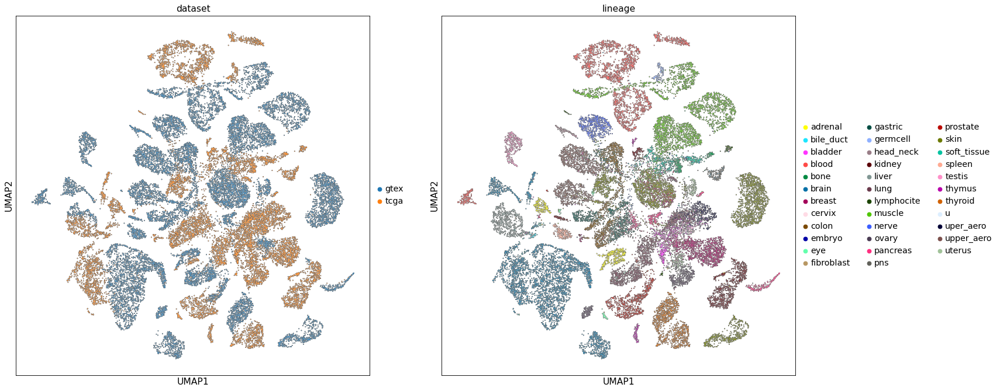

In [60]:
evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['dataset','lineage'],
                    projection="2d",
                    n_neighbors = 8,
                    #rerun=False,
                    add_outline = True,
                    #size = [30 if val != 'tcga' else 10 for val in evaluator.adata_latent.obs['dataset']]
                     )

In [55]:
evaluator = pl.CELLIGNER2_EVAL(cl2n)

In [60]:
evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['dataset','lineage'],
                    projection="2d",
                    n_neighbors = 8,
                    rerun=False,
                    use_genepy=True,
                    add_outline = True,
                    size = [30 if val == 'ccle' else 10 for val in evaluator.adata_latent.obs['dataset']]
                     )

TypeError: scatter() missing 1 required positional argument: 'data'

In [61]:
from genepy.utils import plot

In [63]:
evaluator.adata_latent

AnnData object with n_obs × n_vars = 31667 × 26
    obs: 'dataset', 'lineage', 'age', 'sex', 'lineage_pred', 'age_pred', 'sex_pred', 'leiden'
    uns: 'neighbors', 'leiden', 'umap', 'dataset_colors', 'lineage_colors'
    obsm: 'X_umap'
    obsp: 'distances', 'connectivities'

In [80]:
from bokeh.palettes import Category20_20, Set3_12, Accent8

In [81]:
color = Category20_20+ Set3_12+ Accent8

In [78]:
len(set(evaluator.adata_latent.obs['lineage']))

36

In [ ]:
evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['lineage','dataset', 'sex', 'age'],
                    use_genepy=True
                    projection="2d",
                    n_neighbors = 8,
                    #rerun=False,
                    importance = [0 if val == 'ccle' else 1 for val in evaluator.adata_latent.obs['dataset']],
                    shape = evaluator.adata_latent.obs['dataset'].tolist(),
                    alpha=0.6,
                    radii=5,
                    colprovided=True,
                    folder='temp_plot'
                     )

In [207]:
evaluator

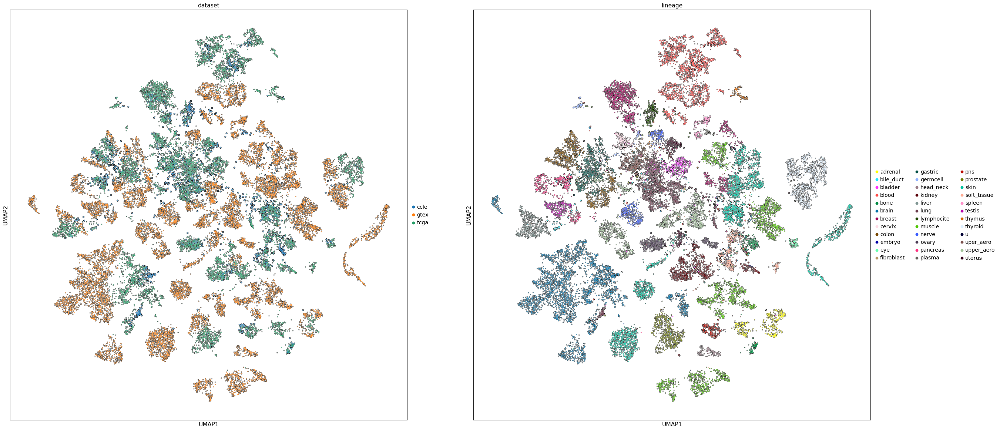

In [57]:
evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['dataset','lineage'],
                    projection="2d",
                    n_neighbors = 8,
                    #rerun=False,
                    add_outline = True,
                    size = [30 if val == 'ccle' else 10 for val in evaluator.adata_latent.obs['dataset']]
                     )

In [105]:
sc.settings.set_figure_params(dpi=500, frameon=False)
sc.set_figure_params(dpi=500)
sc.set_figure_params(figsize=(20, 20))
torch.set_printoptions(precision=3, sci_mode=False, edgeitems=7)

In [118]:
evaluator.adata_latent.obs[['lineage', 'sex', 'age']] = evaluator.model.adata.obs[['lineage', 'sex', 'age']]

### do we have lots of variance?

In [19]:
import umap
import umap.plot

In [ ]:
red = umap.UMAP(densmap=True, dens_lambda=0.1).fit(evaluator.adata_latent.X)

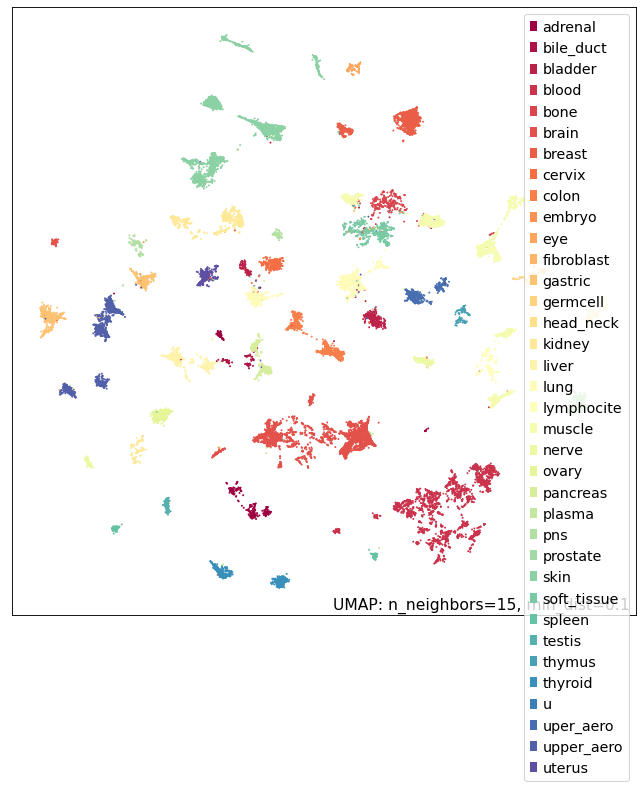

In [29]:
p = umap.plot.points(red, labels=evaluator.adata_latent.obs.lineage)
umap.plot.show(p)

### what about other annotation?

In [31]:
evaluator.adata_latent.obs['disease_type'] = tosend.obs.disease_type

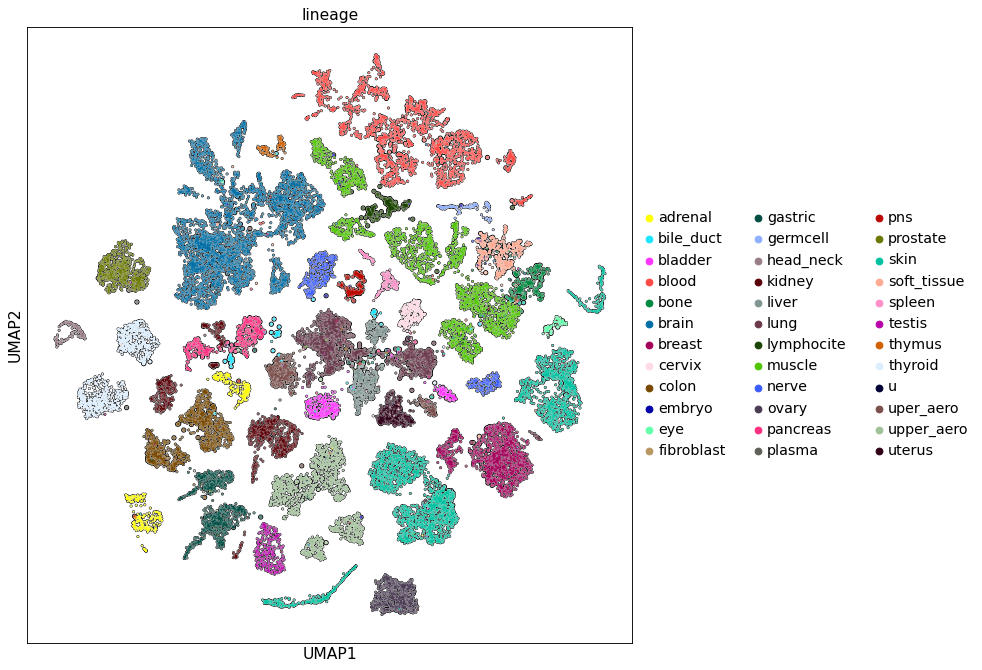

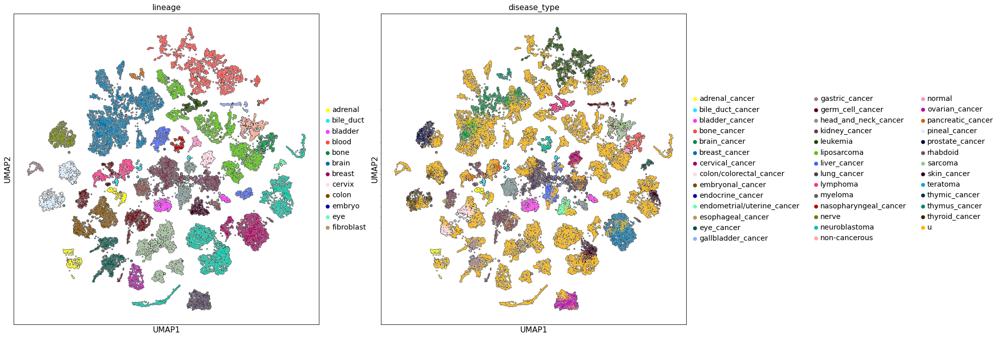

In [33]:
evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['lineage','disease_type'],
                    projection="2d",
                    n_neighbors = 8,
                    rerun=False,
                    add_outline = True,
                    size = [30 if val == 'ccle' else 10 for val in evaluator.adata_latent.obs['dataset']]
                     )

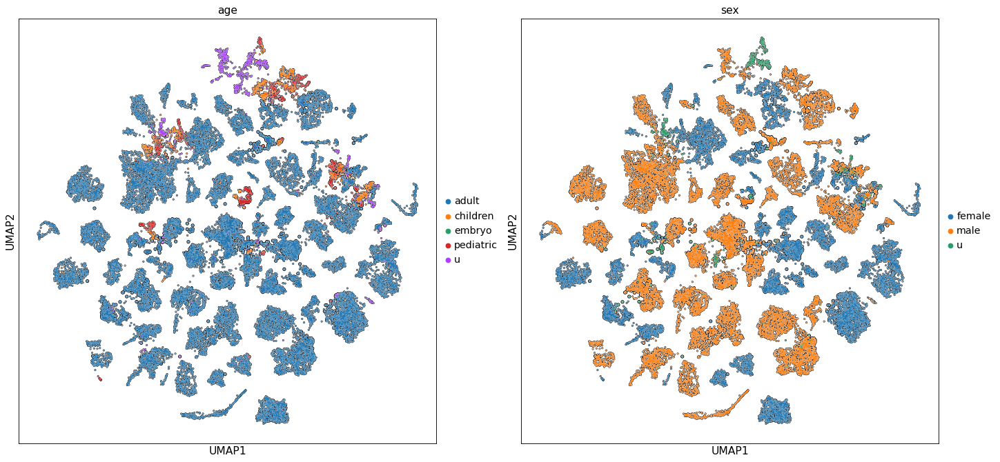

In [34]:
evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['age','sex'],
                    projection="2d",
                    n_neighbors = 8,
                    rerun=False,
                    add_outline = True,
                    size = [30 if val == 'ccle' else 10 for val in evaluator.adata_latent.obs['dataset']]
                     )

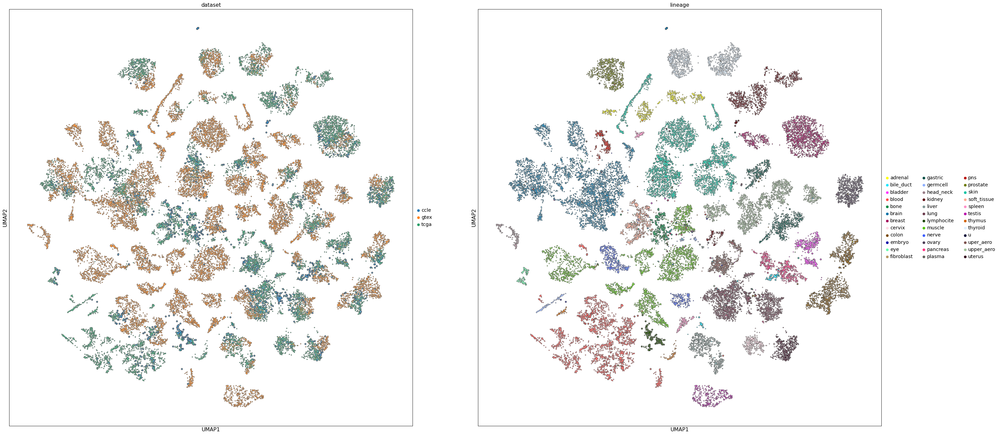

In [106]:
evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['dataset','lineage', 'disease_type'],
                    projection="2d",
                    n_neighbors = 8,
                    rerun=False,
                    add_outline = True,
                    size = [30 if val == 'ccle' else 10 for val in evaluator.adata_latent.obs['dataset']]
                     )

### what about adding another dataset without training

In [99]:
evaluator = pl.CELLIGNER2_EVAL(cl2n, additional_adata=dataset[(dataset.obs.dataset.isin(['cclf', 'cmi-asc', 'cmi-mbc', 'hcmi-cmdc', 'organoid-pancreatic']))])

Therefore integer value of those labels is set to -1


/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'dataset' as categorical
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'lineage' as categorical
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a 

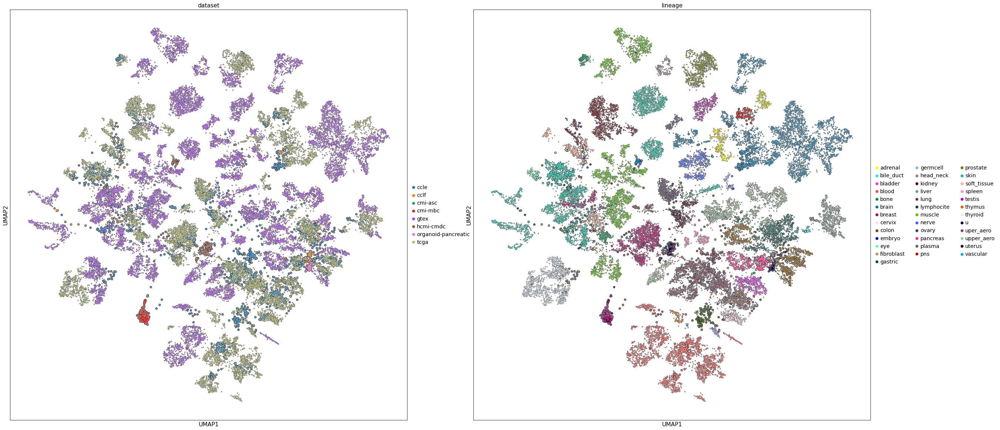

In [100]:
evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['dataset','lineage'],
                    projection="2d",
                    n_neighbors = 8,
                    #rerun=False,
                    add_outline = True,
                    size = [10 if val in ['tcga', 'gtex'] else 40 for val in evaluator.adata_latent.obs['dataset']]
                     )

In [103]:
from collections import Counter

In [ ]:
## is this issue with Breasts a data problem?

In [112]:
Counter(dataset[dataset.obs.dataset=='hcmi-cmdc'].obs.lineage)

Counter({'u': 115,
         'breast': 18,
         'brain': 50,
         'bile_duct': 2,
         'muscle': 3,
         'soft_tissue': 2,
         'gastric': 1,
         'colon': 4,
         'bone': 3,
         'kidney': 1,
         'thyroid': 1})

In [109]:
breasts = dataset[dataset.obs.lineage=='breast']

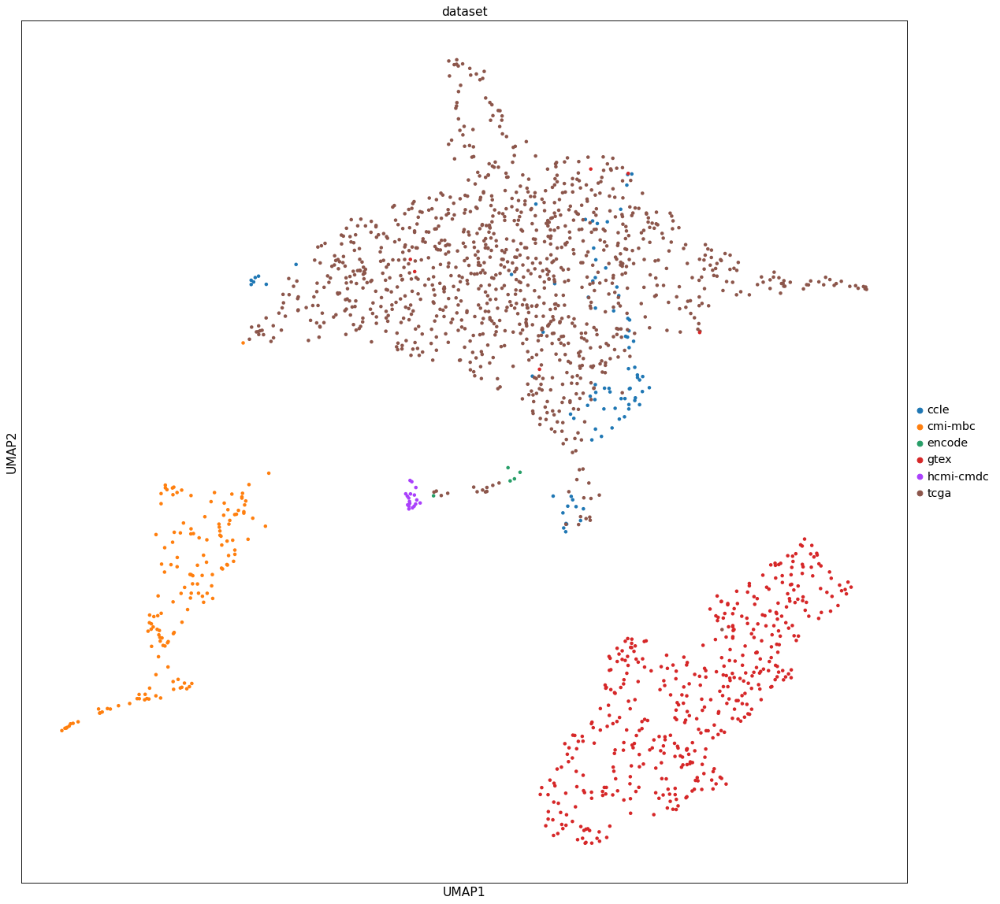

In [111]:
sc.pp.neighbors(breasts, n_neighbors=8)
sc.tl.leiden(breasts)
sc.tl.umap(breasts, n_components=2, min_dist=.5, alpha=1, spread=1, random_state=None)
sc.pl.umap(breasts, color=['dataset'], projection="2d")

In [107]:
Counter(dataset[dataset.obs.dataset=='cmi-asc'].obs.lineage)

Counter({'vascular': 7})

In [108]:
evaluator.get_class_quality(classes=['lineage', 'sex', 'age'], only=['cmi-mbc'], on="dataset")

lineage
all predicted categories:  {'bone', 'uterus', 'upper_aero', 'breast', 'muscle', 'blood', 'gastric', 'bile_duct', 'liver', 'ovary', 'skin'}
accuracy:  0.013157894736842105
F1 Score (weigthed): 0.00
F1 Score (macro): 0.00


sex
all predicted categories:  {'male', 'female'}
accuracy:  1.0
F1 Score (weigthed): 1.00
F1 Score (macro): 1.00


age
all predicted categories:  {'adult'}
accuracy:  1.0
F1 Score (weigthed): 1.00
F1 Score (macro): 1.00


use confusion matrix to get more details


In [101]:
evaluator.get_class_quality(classes=['lineage', 'sex', 'age'], only=['cclf', 'cmi-asc', 'cmi-mbc', 'hcmi-cmdc', 'organoid-pancreatic'], on="dataset")

lineage
all predicted categories:  {'colon', 'uterus', 'breast', 'blood', 'pancreas', 'brain', 'soft_tissue', 'embryo', 'bladder', 'lung', 'bile_duct', 'cervix', 'nerve', 'bone', 'germcell', 'upper_aero', 'muscle', 'uper_aero', 'kidney', 'liver', 'ovary', 'thyroid', 'skin', 'lymphocite', 'gastric', 'fibroblast'}
accuracy:  0.3010471204188482
F1 Score (weigthed): 0.31
F1 Score (macro): 0.24


sex
all predicted categories:  {'male', 'female'}
accuracy:  0.8860103626943006
F1 Score (weigthed): 0.89
F1 Score (macro): 0.88


age
all predicted categories:  {'pediatric', 'children', 'adult'}
accuracy:  0.9521276595744681
F1 Score (weigthed): 0.95
F1 Score (macro): 0.60


use confusion matrix to get more details


In [89]:
evaluator.get_class_quality(classes=['lineage', 'sex', 'age'], only=['cclf'], on="dataset")

lineage
all predicted categories:  {'colon', 'uterus', 'breast', 'blood', 'pancreas', 'brain', 'soft_tissue', 'embryo', 'bladder', 'lung', 'bile_duct', 'cervix', 'nerve', 'bone', 'germcell', 'upper_aero', 'uper_aero', 'kidney', 'liver', 'ovary', 'thyroid', 'skin', 'lymphocite', 'gastric', 'fibroblast'}
accuracy:  0.4420289855072464
F1 Score (weigthed): 0.44
F1 Score (macro): 0.27


sex
all predicted categories:  {'male', 'female'}
accuracy:  0.7322834645669292
F1 Score (weigthed): 0.73
F1 Score (macro): 0.73


age
all predicted categories:  {'pediatric', 'children', 'adult'}
accuracy:  0.7
F1 Score (weigthed): 0.61
F1 Score (macro): 0.49


use confusion matrix to get more details


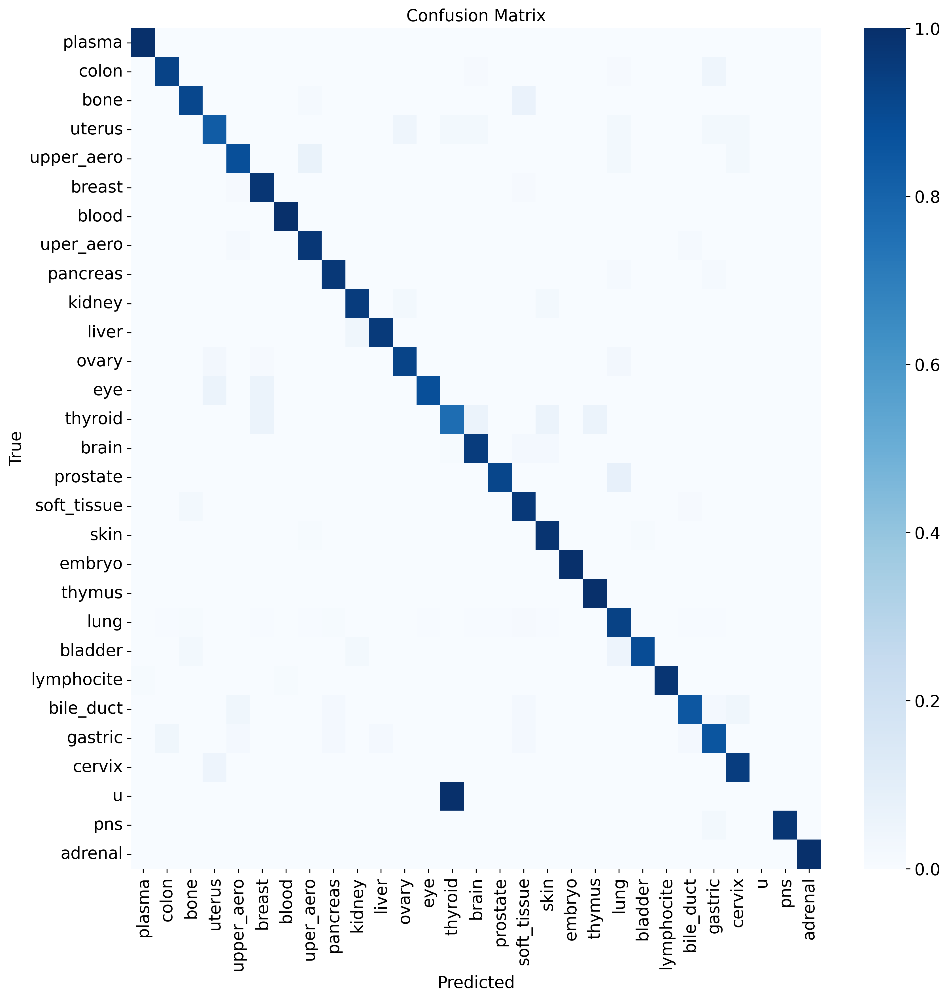

In [91]:
conf = evaluator.get_confusion_matrix(of="lineage", only='ccle', on='dataset', figsize=(13,13))

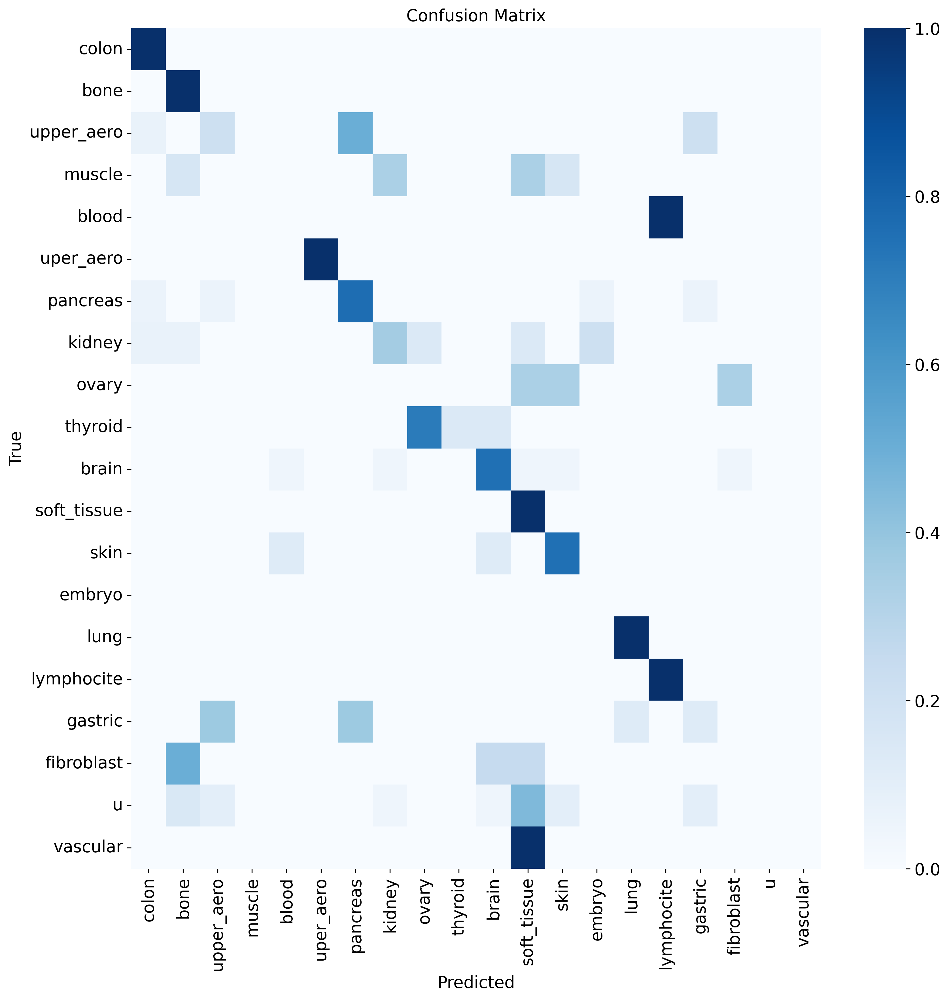

In [90]:
conf = evaluator.get_confusion_matrix(of="lineage", only='cclf', on='dataset', figsize=(13,13))

In [ ]:
cl2n.save("temp/gtex_tcga_ccle")

In [157]:
evaluator.model.model.classifier.n_expand=0

In [ ]:
# look at latent space

In [ ]:
# check against gsea of actual expression

In [258]:
lung_expr = dataset[dataset.obs.dataset.isin(['ccle', 'tcga', 'gtex']) & (dataset.obs.lineage=="lung")].to_df().T

In [227]:
from genepy import rna

In [245]:
from celligner2.plotting import run_gsea

In [264]:
found, _ = rna.convertGenes(
    lung_expr.index.tolist(), from_idtype="ensembl_gene_id", to_idtype="entrezgene_id"
)
lung_expr.index = found
lung_expr = lung_expr[~lung_expr.index.isna()]
lung_expr.index = lung_expr.index.astype(str)
lung_expr = lung_expr[~lung_expr.index.str.startswith("ENS")]
lung_expr.index = lung_expr.index.astype(float).astype(int).astype(str)
lung_expr = pd.DataFrame(lung_expr.mean(1))
lung_expr = lung_expr.reset_index().sort_values(by=0, ascending=False)
res = run_gsea(lung_expr, no_plot=True)

ValueError: Length mismatch: Expected axis has 4915 elements, new values have 5000 elements

In [277]:
baseline_expr = dataset[dataset.obs.dataset.isin(['ccle', 'tcga', 'gtex'])].to_df().T

In [283]:
data = pd.concat([lung_expr,baseline_expr[0]], axis=1)
data.columns = ['index', '0', '1']

In [286]:
res = run_gsea(data, no_plot=True, using='gsea', cls=[0,1])

In [290]:
res[res.pval<0.05].sort_values(by="es", ascending=False).iloc[:20].Term.tolist()

['DESCARTES_MAIN_FETAL_BRONCHIOLAR_AND_ALVEOLAR_EPITHELIAL_CELLS',
 'TRAVAGLINI_LUNG_SIGNALING_ALVEOLAR_EPITHELIAL_TYPE_2_CELL',
 'DESCARTES_FETAL_HEART_ELF3_AGBL2_POSITIVE_CELLS',
 'ZHONG_PFC_C2_UNKNOWN_NPC',
 'DESCARTES_FETAL_STOMACH_MYELOID_CELLS',
 'DURANTE_ADULT_OLFACTORY_NEUROEPITHELIUM_RESPIRATORY_COLUMNAR_CELLS',
 'DESCARTES_MAIN_FETAL_ANTIGEN_PRESENTING_CELLS',
 'DURANTE_ADULT_OLFACTORY_NEUROEPITHELIUM_RESPIRATORY_HORIZONTAL_BASAL_CELLS',
 'DURANTE_ADULT_OLFACTORY_NEUROEPITHELIUM_MONOCYTES',
 'FAN_EMBRYONIC_CTX_MICROGLIA_1',
 'TRAVAGLINI_LUNG_PROLIFERATING_NK_T_CELL',
 'DURANTE_ADULT_OLFACTORY_NEUROEPITHELIUM_MACROPHAGES',
 'DESCARTES_FETAL_PLACENTA_MYELOID_CELLS',
 'DESCARTES_FETAL_LUNG_BRONCHIOLAR_AND_ALVEOLAR_EPITHELIAL_CELLS',
 'TRAVAGLINI_LUNG_MYELOID_DENDRITIC_TYPE_1_CELL',
 'HALLMARK_INTERFERON_GAMMA_RESPONSE',
 'TRAVAGLINI_LUNG_IGSF21_DENDRITIC_CELL',
 'TRAVAGLINI_LUNG_CAPILLARY_AEROCYTE_CELL',
 'HALLMARK_MYC_TARGETS_V2',
 'DESCARTES_FETAL_ADRENAL_MYELOID_CELLS']

In [266]:
res

,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
242,CUI_DEVELOPING_HEART_COMPACT_ATRIAL_CARDIOMYOCYTE,0.898482,1.410424,0.007014,0.026116,15,15,2512;2495;6189;6129;4904;2597;6142;6160;6137;1...,2512;2495;6189;6129;4904;2597;6142;6160
243,TRAVAGLINI_LUNG_NATURAL_KILLER_T_CELL,0.887876,1.398742,0.002008,0.032852,34,18,7503;567;10627;3107;3887;7852;84525;3672;5996;...,7503;567;10627;3107
241,LAKE_ADULT_KIDNEY_C23_ENDOTHELIAL_CELLS_AVR,0.873643,1.409612,0.000000,0.024554,126,110,1915;6175;2512;79026;972;6122;7184;2495;6217;6...,1915;6175;2512;79026;972;6122;7184;2495;6217;6...
246,LAKE_ADULT_KIDNEY_C24_ENDOTHELIAL_CELLS_AEA_AN...,0.860447,1.384865,0.000000,0.045373,152,124,6175;5660;2512;2;79026;972;6122;4627;7184;6217...,6175;5660;2512;2;79026;972;6122;4627;7184;6217...
245,BUSSLINGER_GASTRIC_PPP1R1B_POSITIVE_CELLS,0.859571,1.381879,0.000000,0.045182,121,118,1915;6191;6175;1937;6130;6167;6122;6217;3178;6...,1915;6191;6175;1937;6130;6167;6122;6217;3178;6...
...,...,...,...,...,...,...,...,...,...
503,MANNO_MIDBRAIN_NEUROTYPES_HPERIC,0.657751,1.073913,0.041000,0.477512,795,469,2;4627;2934;633;2034;26986;1281;3872;10628;447...,2;4627;2934;633;2034;26986;1281;3872;10628;447...
317,DESCARTES_FETAL_EYE_SMOOTH_MUSCLE_CELLS,-0.296243,-563.714064,0.000000,0.188312,76,17,4644;5872;387763;51108;4311;6917;23642;3815;79...,4644;5872;387763;51108;4311;6917;23642;3815;79...
231,DESCARTES_FETAL_STOMACH_PARIETAL_AND_CHIEF_CELLS,-0.367668,-1286.838340,0.000000,0.000000,42,22,1846;8639;84706;2243;51706;10202;2244;5160;115...,1846;8639;84706;2243;51706;10202;2244;5160;115...
229,DESCARTES_FETAL_ADRENAL_SYMPATHOBLASTS,-0.410131,-1274.920635,0.000000,0.000000,118,19,57535;1113;5979;5179;26232;5126;7425;8938;9568...,57535;1113;5979;5179;26232;5126;7425;8938;9568...


In [ ]:
# check attention 

In [296]:
res = evaluator.explain_predictions(method="LRP", on="lineage", of="lung", do_gsea=True, no_plot=True, using='gsea', sets=[
            "temp/genesets/h.all.v7.5.1.entrez.gmt",  # hallmark (50)
            "temp/genesets/c6.all.v7.5.1.entrez.gmt",  # C6: oncogenic signature gene sets (189)
            "temp/genesets/c8.all.v7.5.1.entrez.gmt",  # cell type signature gene sets (700)
        ])

/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/captum/_utils/gradient.py:56: UserWarning: Input Tensor 0 did not already require gradients, required_grads has been set automatically.
  warnings.warn(
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/torch/nn/modules/module.py:974: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/captum/_utils/gradient.py:56: UserWarning: Input Tensor 0 did not already require gradients, required_grads has been set automatically.
  warnings.warn(
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/torch/nn/modules/module.py:974: UserWarning: Using a

fetching gene names from biomart cache
4 count not be parsed... we don't have all genes already
fetching gene names from biomart cache
4 count not be parsed... we don't have all genes already
> /home/jeremie/celligner2/celligner2/plotting/celligner2_eval.py(547)explain_predictions()
    545 
    546                 pdb.set_trace()
--> 547                 res.columns = ["index", "0", "1"]
    548                 kwargs["cls"] = [0, 1]
    549             return run_gsea(res, using=using, sets=sets, **kwargs), res

ipdb> res
       index             0         0
4867      60  8.994256e+00  9.863902
4900    1915  6.803691e+00  5.075986
4720    6191  6.450747e+00  6.012712
4780    6175  6.064623e+00  4.683223
4733    1937  5.751225e+00  4.424633
...      ...           ...       ...
46     93377  1.541802e-06  0.000652
4494    5407  1.510669e-06  0.034299
4545    5408  1.403221e-06  0.002118
294   145270  1.148494e-06  0.001562
2482    6822  8.394352e-07  0.001936

[4915 rows x 3 columns]
ip

In [297]:
subres = res[0].sort_values(by="es", ascending=False)

In [298]:
subres[subres.pval<0.05].iloc[:20]

,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
411,FAN_EMBRYONIC_CTX_MICROGLIA_1,0.555229,27.432855,0.000000,0.152170,155,39,5111;50809;4288;54443;7913;7153;23204;84790;11...,5111;50809;4288;54443;7913;7153;23204;84790;11...
439,DURANTE_ADULT_OLFACTORY_NEUROEPITHELIUM_RESPIR...,0.539742,21.000520,0.000000,0.198563,33,32,3880;2810;5349;301;64065;6318;5268;4922;218;48...,3880;2810;5349;301;64065;6318;5268;4922;218;48...
435,DURANTE_ADULT_OLFACTORY_NEUROEPITHELIUM_RESPIR...,0.529029,22.319926,0.000000,0.187849,28,28,3880;2810;2171;7295;64065;6318;4922;218;688;13...,3880;2810;2171;7295;64065;6318;4922;218;688;13...
448,TRAVAGLINI_LUNG_IGSF21_DENDRITIC_CELL,0.506203,17.936035,0.000000,0.238028,46,27,4360;2162;1436;11326;4000;467;22918;7045;79971...,4360;2162;1436;11326;4000;467;22918;7045;79971...
498,DESCARTES_MAIN_FETAL_BRONCHIOLAR_AND_ALVEOLAR_...,0.503796,11.301614,0.006944,0.435859,50,18,653509;6440;6439;3772;11197;177;23250;10577;30...,653509;6440;6439;3772;11197;177;23250;10577;3038
336,BUSSLINGER_ESOPHAGEAL_PROLIFERATING_BASAL_CELLS,0.490931,82.525213,0.000000,0.043625,70,67,1308;3880;445;4288;8140;23224;6142;3914;3181;7...,1308;3880;445;4288;8140;23224;6142;3914;3181;7...
410,TRAVAGLINI_LUNG_PROLIFERATING_NK_T_CELL,0.453505,27.379722,0.000000,0.151089,129,42,5111;4288;4605;8644;11098;7153;5902;3418;10051...,5111;4288;4605;8644;11098;7153;5902;3418;10051...
483,DESCARTES_FETAL_LUNG_BRONCHIOLAR_AND_ALVEOLAR_...,0.447516,12.952384,0.032520,0.366928,70,23,9075;7164;27074;6440;10568;6439;3772;3694;177;...,9075;7164;27074;6440;10568;6439;3772;3694;177;...
412,DURANTE_ADULT_OLFACTORY_NEUROEPITHELIUM_SUSTEN...,0.445680,26.719540,0.030303,0.154979,47,38,6286;3880;8000;92304;11098;4582;7356;2919;4477...,6286;3880;8000;92304;11098;4582;7356;2919;4477...
325,BUSSLINGER_ESOPHAGEAL_EARLY_SUPRABASAL_CELLS,0.436526,108.857356,0.000000,0.035957,79,73,5591;5111;4288;23224;3181;7913;6194;7153;3182;...,5591;5111;4288;23224;3181;7913;6194;7153;3182;...


In [300]:
# just on CCLE
ccle_res = evaluator.explain_predictions(method="LRP", on="lineage", of="lung", dataset="ccle", do_gsea=True, no_plot=True, using='gsea', sets=[
            "temp/genesets/h.all.v7.5.1.entrez.gmt",  # hallmark (50)
            "temp/genesets/c6.all.v7.5.1.entrez.gmt",  # C6: oncogenic signature gene sets (189)
            "temp/genesets/c8.all.v7.5.1.entrez.gmt",  # cell type signature gene sets (700)
        ])

/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/captum/_utils/gradient.py:56: UserWarning: Input Tensor 0 did not already require gradients, required_grads has been set automatically.
  warnings.warn(
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/torch/nn/modules/module.py:974: UserWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  warnings.warn("Using a non-full backward hook when the forward contains multiple autograd Nodes "
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/captum/_utils/gradient.py:56: UserWarning: Input Tensor 0 did not already require gradients, required_grads has been set automatically.
  warnings.warn(
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/torch/nn/modules/module.py:974: UserWarning: Using a

fetching gene names from biomart cache
4 count not be parsed... we don't have all genes already
fetching gene names from biomart cache
4 count not be parsed... we don't have all genes already
> /home/jeremie/celligner2/celligner2/plotting/celligner2_eval.py(547)explain_predictions()
    545 
    546                 pdb.set_trace()
--> 547                 res.columns = ["index", "0", "1"]
    548                 kwargs["cls"] = [0, 1]
    549             return run_gsea(res, using=using, sets=sets, **kwargs), res

ipdb> c


In [303]:
subres = ccle_res[0].sort_values(by="es", ascending=False)

In [ ]:
# https://pubmed.ncbi.nlm.nih.gov/8794409/#:~:text=Cancer%2Dassociated%20retinopathy%20(CAR),autoimmune%20reactions%20directing%20retinal%20antigens.
# https://pubmed.ncbi.nlm.nih.gov/35464891/
# 6 articles talking about retina - 
# could it be that lung cancer originates mostly from the pulmonary plexus - takes on a more prolierative state this way and 
# "In the airways, basal cells can give rise to ciliated, neuroendocrine and club cells [2-5]. Basal cells are progenitor cells closely associated with the basal lamina that maintain airway homeostasis. Basal cells are considered the candidate cell of origin in lung SqCC"

In [304]:
subres[subres.pval<0.05].iloc[:20]

,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
554,DESCARTES_MAIN_FETAL_SATB2_LRRC7_POSITIVE_CELLS,0.599153,3.724523,0.028571,0.830839,147,18,5310;55964;8851;2173;5864;4784;8936;1911;3797;...,5310;55964;8851;2173;5864;4784
435,HU_FETAL_RETINA_AMACRINE,0.547646,4.970673,0.005865,0.481876,64,37,51617;1740;10962;9378;51747;23543;2891;1072;34...,51617;1740;10962;9378;51747;23543;2891;1072;34...
479,DESCARTES_FETAL_HEART_SATB2_LRRC7_POSITIVE_CELLS,0.545688,4.401950,0.016620,0.602812,116,24,6585;491;1463;6664;2173;124925;10485;773;37494...,6585;491;1463;6664;2173;124925;10485;773;37494...
64,CAHOY_NEURONAL,0.507774,4.499713,0.011396,0.588822,100,35,3208;4747;5179;816;2039;4208;24141;2563;2045;5...,3208;4747;5179;816;2039;4208;24141;2563;2045;5...
27,HALLMARK_SPERMATOGENESIS,0.507452,4.549732,0.020408,1.000000,135,30,814;5037;5414;6954;7137;6888;4744;83700;27344;...,814;5037;5414;6954;7137;6888;4744;83700;27344;...
393,GAUTAM_EYE_IRIS_CILIARY_BODY_CRYAA_HIGH_CILIAR...,0.489102,5.707848,0.003534,0.383278,82,49,1288;4684;56937;7052;7070;23037;23062;4084;287...,1288;4684;56937;7052;7070;23037;23062;4084;287...
54,NRL_DN.V1_UP,0.471267,4.916524,0.026059,0.482652,136,42,6326;7033;1995;6830;4208;7139;6954;51809;9262;...,6326;7033;1995;6830;4208;7139;6954;51809;9262;...
60,E2F3_UP.V1_UP,0.466484,4.925905,0.006309,0.570898,190,52,4747;29767;55964;25884;4884;5426;146330;6853;8...,4747;29767;55964;25884;4884;5426;146330;6853;8...
521,HU_FETAL_RETINA_PHOTORECEPTOR,0.453008,4.098032,0.040816,0.732596,71,31,219287;50939;816;2173;157627;3021;6616;10912;5...,219287;50939;816;2173;157627;3021;6616;10912;5...
391,DESCARTES_FETAL_LUNG_VISCERAL_NEURONS,0.452335,5.624240,0.014134,0.379204,212,71,51617;51286;219287;55964;1995;1641;478;491;885...,51617;51286;219287;55964;1995;1641;478;491;885...


In [ ]:
# with prerank on ccle only

In [214]:
subres

,Term,es,nes,pval,fdr,geneset_size,matched_size,genes,ledge_genes
242,CUI_DEVELOPING_HEART_COMPACT_ATRIAL_CARDIOMYOCYTE,0.898482,1.410424,0.007014,0.026116,15,15,2512;2495;6189;6129;4904;2597;6142;6160;6137;1...,2512;2495;6189;6129;4904;2597;6142;6160
243,TRAVAGLINI_LUNG_NATURAL_KILLER_T_CELL,0.887876,1.398742,0.002008,0.032852,34,18,7503;567;10627;3107;3887;7852;84525;3672;5996;...,7503;567;10627;3107
241,LAKE_ADULT_KIDNEY_C23_ENDOTHELIAL_CELLS_AVR,0.873643,1.409612,0.000000,0.024554,126,110,1915;6175;2512;79026;972;6122;7184;2495;6217;6...,1915;6175;2512;79026;972;6122;7184;2495;6217;6...
246,LAKE_ADULT_KIDNEY_C24_ENDOTHELIAL_CELLS_AEA_AN...,0.860447,1.384865,0.000000,0.045373,152,124,6175;5660;2512;2;79026;972;6122;4627;7184;6217...,6175;5660;2512;2;79026;972;6122;4627;7184;6217...
245,BUSSLINGER_GASTRIC_PPP1R1B_POSITIVE_CELLS,0.859571,1.381879,0.000000,0.045182,121,118,1915;6191;6175;1937;6130;6167;6122;6217;3178;6...,1915;6191;6175;1937;6130;6167;6122;6217;3178;6...
248,TRAVAGLINI_LUNG_CD4_NAIVE_T_CELL,0.857558,1.375241,0.000000,0.047230,132,93,1915;6175;6167;6122;6217;6208;6143;6132;6136;4...,1915;6175;6167;6122;6217;6208;6143;6132;6136;4...
244,LAKE_ADULT_KIDNEY_C7_PROXIMAL_TUBULE_EPITHELIA...,0.856327,1.380219,0.000000,0.043229,135,116,1915;6191;5660;2512;6130;6167;6122;2495;6217;6...,1915;6191;5660;2512;6130;6167;6122;2495;6217;6...
265,DESCARTES_MAIN_FETAL_VISCERAL_NEURONS,0.856028,1.329662,0.028169,0.084148,85,17,203068;7345;7280;7532;10493;376267;10381;10468...,203068;7345
247,BUSSLINGER_GASTRIC_LYZ_POSITIVE_CELLS,0.854819,1.372899,0.000000,0.047139,111,105,1915;6191;6175;1937;6130;6167;6122;6208;6143;1...,1915;6191;6175;1937;6130;6167;6122;6208;6143;1...
50,KRAS.50_UP.V1_UP,0.849349,1.338994,0.006000,0.070003,48,29,2;3673;2119;3689;51129;4320;50486;4897;55885;9...,2


In [ ]:
# looking at difference between TCGA and CCLE

In [ ]:
evaluator.explain_predictions()

In [305]:
# reconstruction

/home/jeremie/celligner2/celligner2/plotting/celligner2_eval.py:443: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  full = full.append(val)
/home/jeremie/celligner2/celligner2/plotting/celligner2_eval.py:446: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  fullobs = fullobs.append(v)


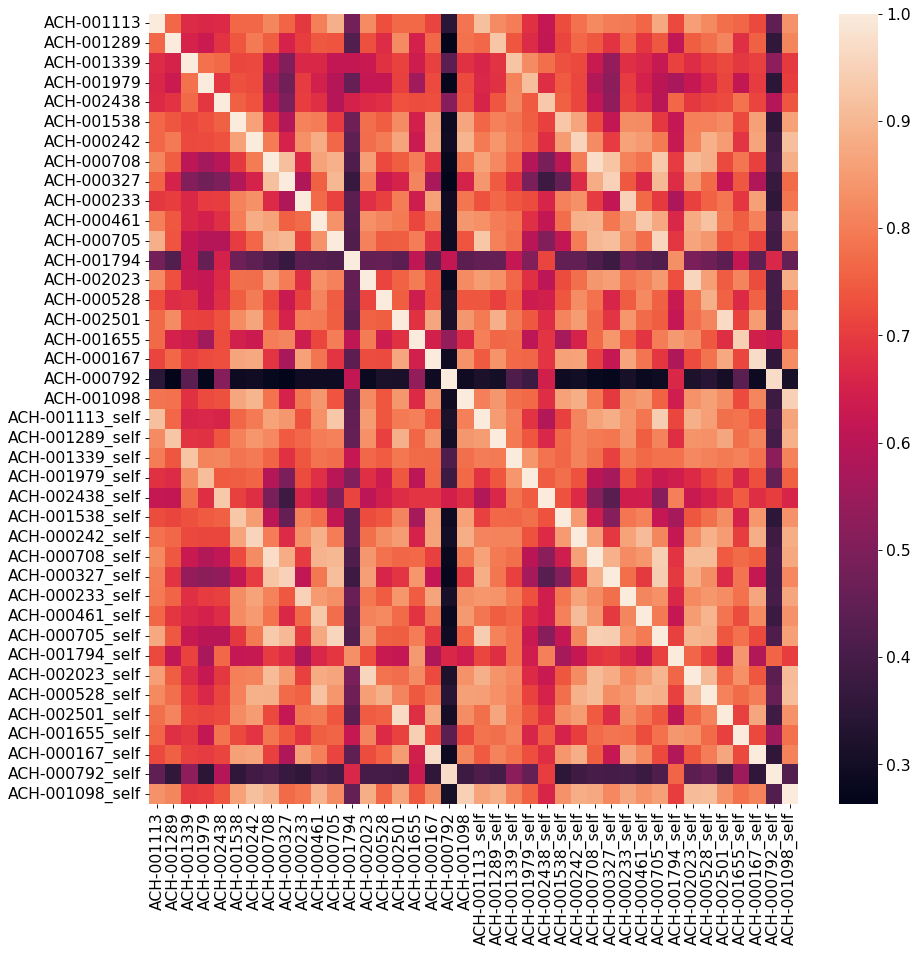

In [326]:
size = 20
corr = evaluator.compare_to(evaluator.reconstruct(samples=cl2n.adata.obs.iloc[:size].index))

/home/jeremie/celligner2/celligner2/plotting/celligner2_eval.py:443: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  full = full.append(val)
/home/jeremie/celligner2/celligner2/plotting/celligner2_eval.py:446: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  fullobs = fullobs.append(v)
/home/jeremie/celligner2/celligner2/plotting/celligner2_eval.py:443: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  full = full.append(val)
/home/jeremie/celligner2/celligner2/plotting/celligner2_eval.py:446: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  fullobs = fullobs.append(v)


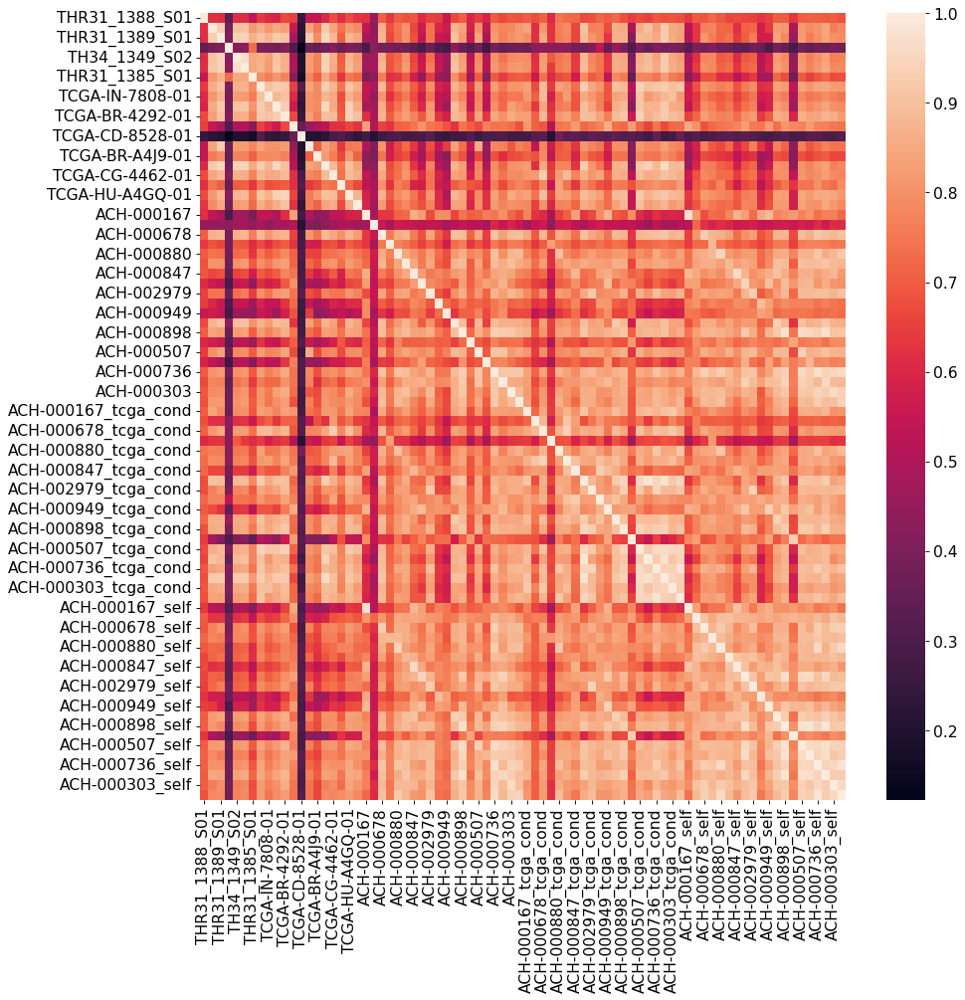

In [345]:
size = 20
sa = cl2n.adata.obs
cl = sa[(sa.lineage=='gastric')&(sa.dataset=='ccle')].iloc[:size]
tm = sa[(sa.lineage=='gastric')&(sa.dataset=='tcga')].iloc[:size]

reco = evaluator.reconstruct(samples=cl.index, tcga_cond=tm)
corr = evaluator.compare_to(reco, samples=tm.index)

In [316]:
conf = evaluator.get_class_quality(classes=["lineage", "sex", "age"], on='dataset', only="cmi-asc")

lineage
all predicted categories:  {'uterus', 'upper_aero', 'muscle', 'blood', 'soft_tissue'}
accuracy:  0.0
F1 Score (weigthed): 0.00
F1 Score (macro): 0.00


sex
all predicted categories:  {'male', 'female'}
accuracy:  1.0
F1 Score (weigthed): 1.00
F1 Score (macro): 1.00


age
all predicted categories:  {'children', 'adult'}
accuracy:  0.8571428571428571
F1 Score (weigthed): 0.79
F1 Score (macro): 0.46


use confusion matrix to get more details


### completely unsupervised

In [395]:
cl2n = celligner2.CELLIGNER2(
    adata=tosend,
    condition_keys=['dataset'],
    predictor_keys=[],#['lineage', 'age', "sex"],
    hidden_layer_sizes=[512, 256],
    classifier_hidden_layer_sizes=[32, 64],
    use_mmd = True,
    latent_dim=42,
    beta=100,
    betaclass=0.8,
    apply_log=False,
    miss='u',
    #mmd_on='y1'
    #recon_loss="mse",
)
cl2n.train(
    n_epochs=500,
    alpha_epoch_anneal=200,
    #cell_type_key='lineage',
    early_stopping_kwargs= {
        "early_stopping_metric": "val_unweighted_loss",
        "threshold": 0,
        "patience": 40,
        "reduce_lr": True,
        "lr_patience": 13,
        "lr_factor": 0.1,
    },
    alpha_kl=0.001,
    train_frac=0.8,
    batch_size=140,
    #monitor_only_val=False,
    n_workers=12,
    leiden_resolution=1.4,
    min_weight=0.000001,
)

/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/torch/nn/init.py:388: UserWarning: Initializing zero-element tensors is a no-op
  warnings.warn("Initializing zero-element tensors is a no-op")
         Falling back to preprocessing with `sc.pp.pca` and default params.


main dataset not in conditions, removing..

INITIALIZING NEW NETWORK..............
Encoder Architecture:
 Layer in, out and cond: 5000 512 3
	Hidden Layer 1 in/out: 512 256
	Mean/Var Layer in/out: 256 42
Classifier Architecture:
	First Layer in/out/expand:  42 32 0
	Hidden Layer 1 in/out: 32 64
	Output Layer in/out:  64 0 

Decoder Architecture:
	First Layer in, out and cond:  42 256 3
	Hidden Layer 1 in/out: 256 512
	Output Layer in/out:  512 5000 

using leiden clustering to define training group mixing
found 23 clusters for dataset ccle


         Falling back to preprocessing with `sc.pp.pca` and default params.


found 45 clusters for dataset gtex


         Falling back to preprocessing with `sc.pp.pca` and default params.


found 38 clusters for dataset tcga


/home/jeremie/celligner2/celligner2/dataset/celligner2/anndata.py:53: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  self.goodloc = torch.tensor(goodloc, dtype=torch.bool)
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/torch/utils/data/dataloader.py:478: UserWarning: This DataLoader will create 12 worker processes in total. Our suggested max number of worker in current system is 8, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


 |█████---------------| 25.2%  - val_loss: 39302.2564236111 - val_recon_loss: 38966.7016493056 - val_kl_loss: 173.3133999295 - val_class_ce_loss: 0.0000000000 - val_mmd_loss: 335.4454240587
ADJUSTED LR
 |█████---------------| 29.6%  - val_loss: 39035.7447048611 - val_recon_loss: 38734.4393229167 - val_kl_loss: 173.2345675998 - val_class_ce_loss: 0.0000000000 - val_mmd_loss: 301.1762949626
ADJUSTED LR
 |███████-------------| 37.0%  - val_loss: 39016.9393229167 - val_recon_loss: 38715.0506944444 - val_kl_loss: 173.2253177219 - val_class_ce_loss: 0.0000000000 - val_mmd_loss: 301.7285359701
ADJUSTED LR
 |███████-------------| 39.6%  - val_loss: 39021.3605902778 - val_recon_loss: 38717.4209201389 - val_kl_loss: 173.2242736816 - val_class_ce_loss: 0.0000000000 - val_mmd_loss: 303.7678202311
ADJUSTED LR
 |████████------------| 42.2%  - val_loss: 39014.7592013889 - val_recon_loss: 38716.7719618056 - val_kl_loss: 173.2236463759 - val_class_ce_loss: 0.0000000000 - val_mmd_loss: 297.8153493245
AD

In [396]:
evaluator = pl.CELLIGNER2_EVAL(cl2n)

/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [397]:
evaluator.adata_latent.obs[['lineage', 'sex', 'age']] = tosend.obs[['lineage', 'sex', 'age']]

/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [398]:
sc.settings.set_figure_params(dpi=500, frameon=False)
sc.set_figure_params(dpi=500)
sc.set_figure_params(figsize=(18, 18))
torch.set_printoptions(precision=3, sci_mode=False, edgeitems=7)

/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/ipykernel/ipkernel.py:287: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


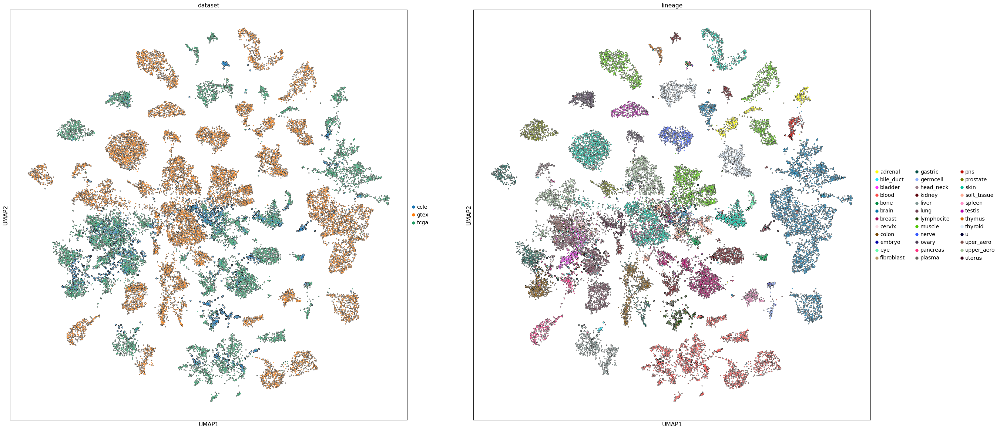

In [399]:
## large latent space version
evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['dataset','lineage'],
                    projection="2d",
                    n_neighbors = 8,
                    #rerun=False,
                    #use_genepy=True,
                    add_outline = True,
                    size = [30 if val == 'ccle' else 10 for val in evaluator.adata_latent.obs['dataset']]
                     )

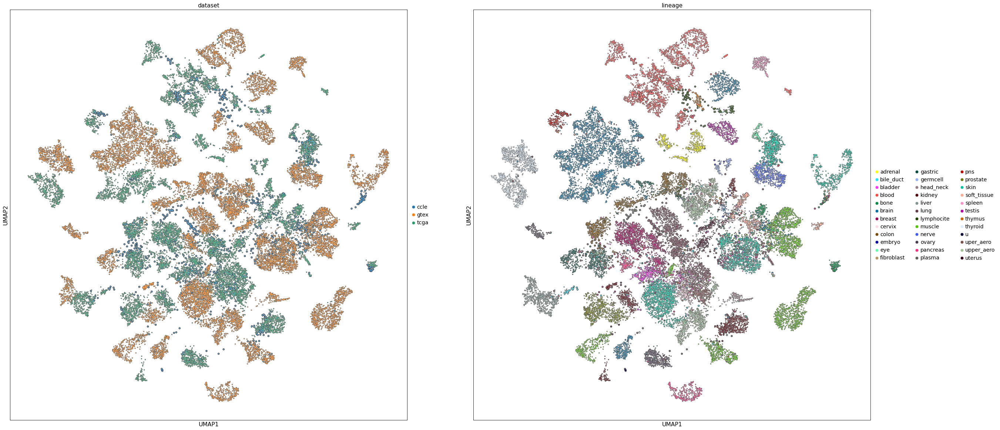

In [371]:
# large nn version
evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['dataset','lineage'],
                    projection="2d",
                    n_neighbors = 8,
                    #rerun=False,
                    #use_genepy=True,
                    add_outline = True,
                    size = [30 if val == 'ccle' else 10 for val in evaluator.adata_latent.obs['dataset']]
                     )

In [377]:
evaluator.model.save('temp/model-tcga_ccle_gtex-large-unsup')

> /home/jeremie/celligner2/celligner2/othermodels/base/_base.py(36)_get_user_attributes()
     34 
     35         pdb.set_trace()
---> 36         attributes = inspect.getmembers(self, lambda a: not (inspect.isroutine(a)))
     37         attributes = [
     38             a for a in attributes if not (a[0].startswith("__") and a[0].endswith("__"))

ipdb> c


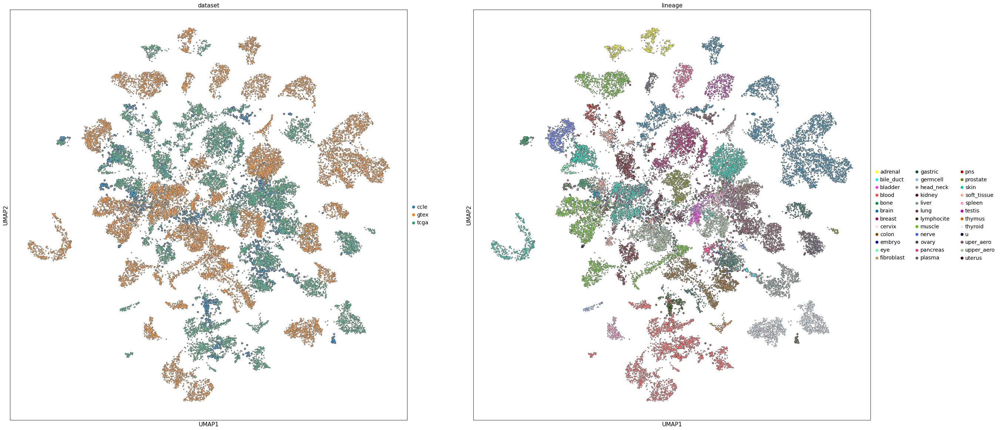

In [386]:
# small nn version
evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['dataset','lineage'],
                    projection="2d",
                    n_neighbors = 8,
                    #rerun=False,
                    #use_genepy=True,
                    add_outline = True,
                    size = [30 if val == 'ccle' else 10 for val in evaluator.adata_latent.obs['dataset']]
                     )

In [387]:
evaluator.model.save('temp/model-tcga_ccle_gtex-small-unsup')

> /home/jeremie/celligner2/celligner2/othermodels/base/_base.py(36)_get_user_attributes()
     34 
     35         pdb.set_trace()
---> 36         attributes = inspect.getmembers(self, lambda a: not (inspect.isroutine(a)))
     37         attributes = [
     38             a for a in attributes if not (a[0].startswith("__") and a[0].endswith("__"))

ipdb> c


In [10]:
cl2 = celligner2.CELLIGNER2.load('temp/model-tcga_ccle_gtex-large-unsup', adata=dataset[dataset.obs.dataset.isin(['ccle', 'tcga', 'gtex'])])
#gtex_tcga_ccle

AnnData object with n_obs × n_vars = 31667 × 5000
    obs: 'disease_type', 'dataset', 'participant_id', 'disease_subtype', 'collection_site', 'doublingt', 'hasebv', 'instability', 'ethnicity', 'morphology', 'sample_name', 'age', 'base_media', 'sex', 'sequencer', 'sample_type', 'tissue_id', 'lineage', 'autolysis_score', 'rin', 'cell_format', 'passage_number', 'assay', 'history', 'contamination', 'leiden'
dict_keys(['apply_log_', 'beta_', 'betaclass_', 'classifier_hidden_layer_sizes_', 'condition_keys_', 'condition_set_', 'conditions_', 'dr_rate_', 'expimap_mode_', 'ext_mask_', 'ext_n_unconstrained_', 'hidden_layer_sizes_', 'hsic_one_vs_all_', 'input_dim_', 'is_trained_', 'latent_dim_', 'main_dataset_', 'mask_', 'miss_', 'mmd_boundary_', 'mmd_on_', 'n_expand_', 'n_unconstrained_', 'predictor_keys_', 'predictor_set_', 'predictors_', 'recon_loss_', 'use_bn_', 'use_hsic_', 'use_l_encoder_', 'use_ln_', 'use_mmd_', 'use_own_kl_'])
main dataset not in conditions, removing..

INITIALIZING NEW N

/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/torch/nn/init.py:388: UserWarning: Initializing zero-element tensors is a no-op
  warnings.warn("Initializing zero-element tensors is a no-op")


In [15]:
evaluator = pl.CELLIGNER2_EVAL(cl2)

In [16]:
evaluator.adata_latent.obs['name'] = evaluator.adata_latent.obs.index

In [25]:
evaluator.adata_latent.obs[['lineage', 'sex', 'age', 'disease_type', 'dataset', 'disease_subtype']] = dataset[dataset.obs.dataset.isin(['ccle', 'tcga', 'gtex'])].obs[['lineage', 'sex', 'age', 'disease_type','dataset', 'disease_subtype']]

In [26]:
p = evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['dataset','lineage', 'disease_type', 'disease_subtype', 'sex', 'age', 'name'],
                    projection="2d",
                    n_neighbors = 8,
                    rerun=False,
                    use_genepy=True,
                    add_outline = True,
                    size = [5 if val == 'ccle' else 2 for val in evaluator.adata_latent.obs['dataset']],
                    folder="out/",
                    searchbox=True,
                     )

/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/bokeh/io/saving.py:142: UserWarning: save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN
  warn("save() called but no resources were supplied and output_file(...) was never called, defaulting to resources.CDN")
/home/jeremie/miniconda3/envs/gae/lib/python3.8/site-packages/bokeh/io/saving.py:154: UserWarning: save() called but no title was supplied and output_file(...) was never called, using default title 'Bokeh Plot'
  warn("save() called but no title was supplied and output_file(...) was never called, using default title 'Bokeh Plot'")


AttributeError: unexpected attribute 'output_backend' to Column, possible attributes are align, aspect_ratio, background, children, css_classes, disabled, height, height_policy, js_event_callbacks, js_property_callbacks, margin, max_height, max_width, min_height, min_width, name, rows, sizing_mode, spacing, subscribed_events, syncable, tags, visible, width or width_policy

In [ ]:
cl2 = celligner2.CELLIGNER2..load_query_data(adata=dataset[dataset.obs.dataset.isin(['hcmi', 'met500', 'cclf']) & ~dataset.obs.lineage.isin(['testis', 'ampulla of vater', 'brain', 'oral', 'stomach', 'gall_bladder'])].copy(), reference_model='temp/subdataset_learning_target', hidden_layer_sizes = [512, 256]

In [15]:
evaluator = pl.CELLIGNER2_EVAL(cl2)

In [16]:
evaluator.adata_latent.obs['name'] = evaluator.adata_latent.obs.index

In [25]:
evaluator.adata_latent.obs[['lineage', 'sex', 'age', 'disease_type', 'dataset', 'disease_subtype']] = dataset[dataset.obs.dataset.isin(['ccle', 'tcga', 'gtex'])].obs[['lineage', 'sex', 'age', 'disease_type','dataset', 'disease_subtype']]

In [ ]:
p = evaluator.plot_latent(umap_kwargs=dict( 
                            n_components=2,
                            min_dist=.5,
                            alpha=1,
                            spread=1,
                            random_state=None),
                    color=['dataset','lineage', 'disease_type', 'disease_subtype', 'sex', 'age', 'name'],
                    projection="2d",
                    n_neighbors = 8,
                    rerun=False,
                    use_genepy=True,
                    add_outline = True,
                    size = [5 if val == 'ccle' else 2 for val in evaluator.adata_latent.obs['dataset']],
                    folder="out/",
                    searchbox=True,
                     )

In [13]:
cl2n.save("temp/target_gtex_tcga-noclass")

> /home/jeremie/celligner2/celligner2/othermodels/base/_base.py(36)_get_user_attributes()
     34 
     35         pdb.set_trace()
---> 36         attributes = inspect.getmembers(self, lambda a: not (inspect.isroutine(a)))
     37         attributes = [
     38             a for a in attributes if not (a[0].startswith("__") and a[0].endswith("__"))

ipdb> c
